<a href="https://colab.research.google.com/github/wel51x/AB-Demo/blob/master/My_LS_DS_442_Convolutional_Neural_Networks_Assignment_v2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<img align="left" src="https://lever-client-logos.s3.amazonaws.com/864372b1-534c-480e-acd5-9711f850815c-1524247202159.png" width=200>
<br></br>
<br></br>

## *Data Science Unit 4 Sprint 4 Lesson 1*

# Convolutional Neural Networks (CNNs)
## _aka_ COMPUTER VISION!

![An XKCD that hasn't quite aged so well](https://imgs.xkcd.com/comics/tasks.png)

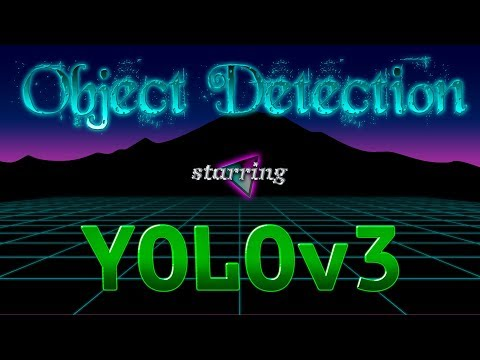

In [0]:
from IPython.display import YouTubeVideo
YouTubeVideo('MPU2HistivI', width=1050, height=700)

# Lecture

## Transfer Learning - TensorFlow Hub

"A library for reusable machine learning modules"

This lets you quickly take advantage of a model that was trained with thousands of GPU hours. It also enables transfer learning - reusing a part of a trained model (called a module) that includes weights and assets, but also training the overall model some yourself with your own data. The advantages are fairly clear - you can use less training data, have faster training, and have a model that generalizes better.

https://www.tensorflow.org/hub/

**WARNING** - Dragons ahead!

![Dragon](https://upload.wikimedia.org/wikipedia/commons/thumb/d/d8/Friedrich-Johann-Justin-Bertuch_Mythical-Creature-Dragon_1806.jpg/637px-Friedrich-Johann-Justin-Bertuch_Mythical-Creature-Dragon_1806.jpg)

TensorFlow Hub is very bleeding edge, and while there's a good amount of documentation out there, it's not always updated or consistent. You'll have to use your problem-solving skills if you want to use it!

In [0]:
# Step 0 - Imports
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image, ImageOps
from scipy.spatial import cKDTree
from skimage.feature import plot_matches
from skimage.measure import ransac
from skimage.transform import AffineTransform
import tensorflow as tf
import tensorflow_hub as hub

## Convolutional Neural Networks

Like neural networks themselves, CNNs are inspired by biology - specifically, the receptive fields of the visual cortex.

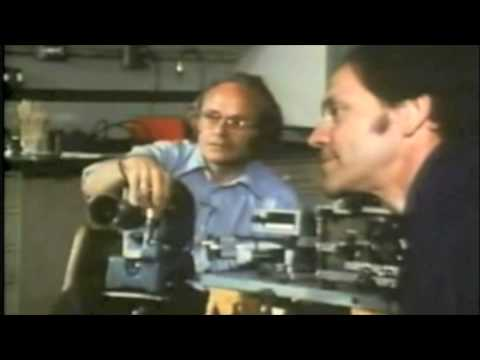

In [0]:
from IPython.display import YouTubeVideo
YouTubeVideo('IOHayh06LJ4', width=1050, height=700)

## A Typical CNN

![A Typical CNN](https://upload.wikimedia.org/wikipedia/commons/thumb/6/63/Typical_cnn.png/800px-Typical_cnn.png)

The first stage of a CNN is, unsurprisingly, a convolution - specifically, a transformation that maps regions of the input image to neurons responsible for receiving them. The convolutional layer can be visualized as follows:

![Convolutional layer](https://upload.wikimedia.org/wikipedia/commons/6/68/Conv_layer.png)

The red represents the original input image, and the blue the neurons that correspond.

As shown in the first image, a CNN can have multiple rounds of convolutions, [downsampling](https://en.wikipedia.org/wiki/Downsampling_(signal_processing)) (a digital signal processing technique that effectively reduces the information by passing through a filter), and then eventually a fully connected neural network and output layer. Typical output layers for a CNN would be oriented towards classification or detection problems - e.g. "does this picture contain a cat, a dog, or some other animal?"

Why are CNNs so popular?

1. They work, really well (see XKCD at top)
2. Compared to prior image learning techniques, they require relatively little image preprocessing (cropping/centering, rotating, normalizing, etc.)
3. Relatedly, they are *robust* to all sorts of common problems in images (shifts, lighting, perspective etc.)

Actually training a cutting edge image classification CNN is nontrivial computationally - the good news is, with transfer learning, we can get one "off-the-shelf"!

# Assignment

Load a pretrained network from TensorFlow Hub, [ResNet50](https://tfhub.dev/google/imagenet/resnet_v1_50/classification/1) - a 50 layer deep network trained to recognize [1000 objects](https://storage.googleapis.com/download.tensorflow.org/data/ImageNetLabels.txt). Starting usage:

```python
module = hub.Module("https://tfhub.dev/google/imagenet/resnet_v1_50/classification/1")
height, width = hub.get_expected_image_size(module)
images = ...  # A batch of images with shape [batch_size, height, width, 3].
logits = module(images)  # Logits with shape [batch_size, num_classes].
```

Apply it to classify the images downloaded below (images from a search for animals in national parks):

In [0]:
!pip install google_images_download

     |████████████████████████████████| 911kB 7.0MB/s 
  Stored in directory: /root/.cache/pip/wheels/22/f3/7b/d1d7a18d9784458622ef3f9702c0bdbc179b431adde169c1a0
Successfully built google-images-download


In [0]:
from google_images_download import google_images_download

response = google_images_download.googleimagesdownload()
arguments = {"keywords": "animal national park", "limit": 20,
             "print_urls": True}
absolute_image_paths = response.download(arguments)


Item no.: 1 --> Item name = animal national park
Evaluating...
Starting Download...
Image URL: https://i.ytimg.com/vi/P8NJa_YoRxk/maxresdefault.jpg
Completed Image ====> 1.maxresdefault.jpg
Image URL: https://npca.s3.amazonaws.com/images/8135/2c7e0d75-c7ff-4336-99d7-259448d03a4d-banner.jpg?1445969501
Completed Image ====> 2.2c7e0d75-c7ff-4336-99d7-259448d03a4d-banner.jpg
Image URL: https://www.nps.gov/arch/learn/nature/images/ARK_6.jpg?maxwidth=1200&maxheight=1200&autorotate=false
Completed Image ====> 3.ARK_6.jpg
Image URL: https://greenglobaltravel.com/wp-content/uploads/2017/04/Best-National-Parks-In-USA-For-Wildlife-Watching.jpg
Completed Image ====> 4.Best-National-Parks-In-USA-For-Wildlife-Watching.jpg
Image URL: https://www.nps.gov/voya/learn/nature/images/VOYA_web_deer.jpg?maxwidth=1200&maxheight=1200&autorotate=false
Completed Image ====> 5.VOYA_web_deer.jpg
Image URL: https://www.kideponationalpark.com/wp-content/uploads/2016/11/zebras-in-kidepo-750x450.jpg
Completed Image =

In [0]:
absolute_image_paths

({'animal national park': ['/content/downloads/animal national park/1.maxresdefault.jpg',
   '/content/downloads/animal national park/2.2c7e0d75-c7ff-4336-99d7-259448d03a4d-banner.jpg',
   '/content/downloads/animal national park/3.ARK_6.jpg',
   '/content/downloads/animal national park/4.Best-National-Parks-In-USA-For-Wildlife-Watching.jpg',
   '/content/downloads/animal national park/5.VOYA_web_deer.jpg',
   '/content/downloads/animal national park/6.zebras-in-kidepo-750x450.jpg',
   '/content/downloads/animal national park/7.spot-denali-national-parks-animals.jpg',
   '/content/downloads/animal national park/8.Royal-Bengal-Tiger.jpg',
   '/content/downloads/animal national park/9.addo-elephant-national-park-elephants-590x390.jpg',
   '/content/downloads/animal national park/10.084ac382-5aff-4674-9555-482e5ff07c0b-banner.jpg',
   '/content/downloads/animal national park/11.Gir-Forest-National-Park-1.jpg',
   '/content/downloads/animal national park/12.2014-06-03-ChitwanNationalParkOl

Report both the most likely estimated class for any image, and also investigate (a) images where the classifier isn't that certain (the best estimate is low), and (b) images where the classifier fails.

Answer (in writing in the notebook) the following - "What sorts of images do CNN classifiers do well with? What sorts do they not do so well? And what are your hypotheses for why?"


Image size =  (1200, 800) Image:


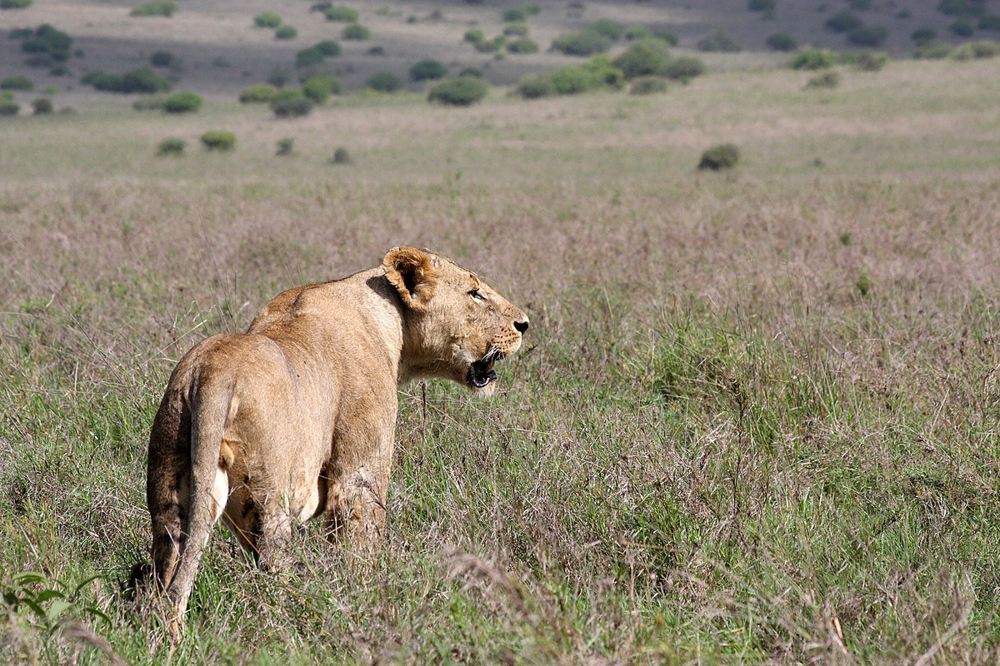

'Image is most likely (with probability):'

[('n02129165', 'lion', 0.953786),
 ('n02130308', 'cheetah', 0.03597536),
 ('n02117135', 'hyena', 0.009789899)]


Image size =  (980, 551) Image:


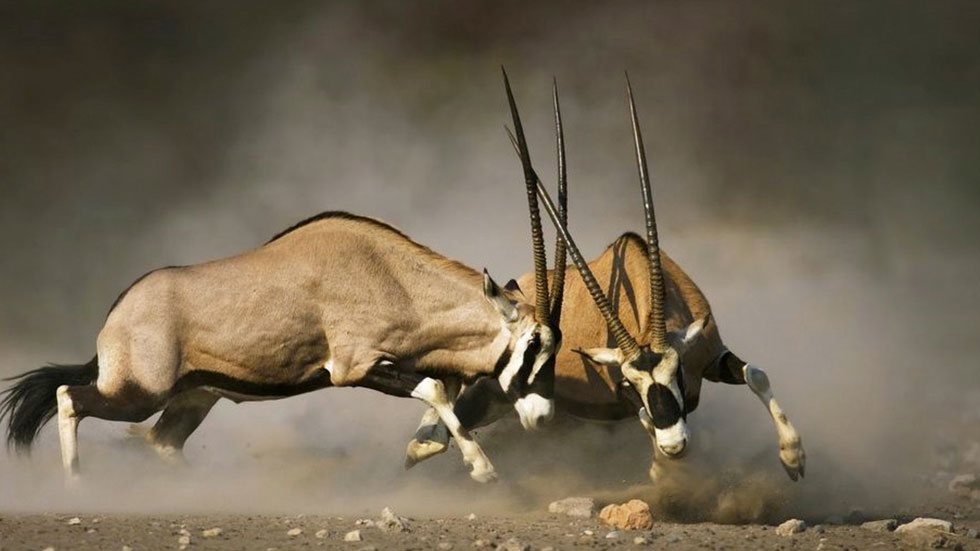

'Image is most likely (with probability):'

[('n02423022', 'gazelle', 0.25012523),
 ('n02417914', 'ibex', 0.13176751),
 ('n02410509', 'bison', 0.1158902)]


Image size =  (960, 363) Image:


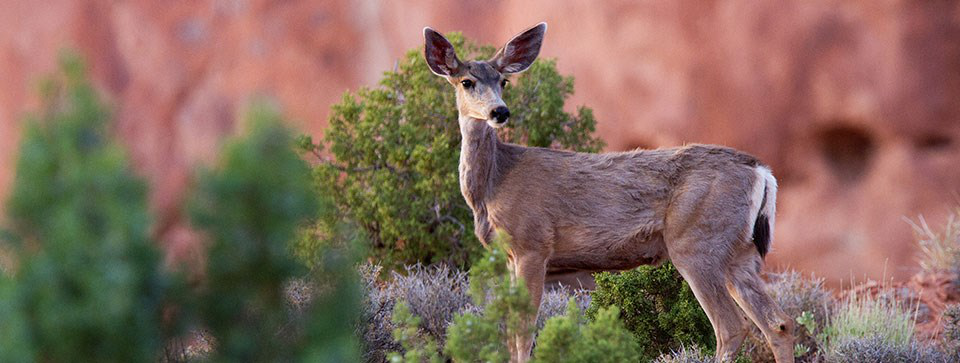

'Image is most likely (with probability):'

[('n03498962', 'hatchet', 0.17266525),
 ('n02415577', 'bighorn', 0.12721537),
 ('n01877812', 'wallaby', 0.069408)]


Image size =  (688, 247) Image:


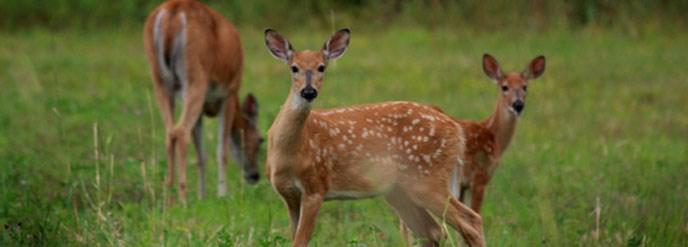

'Image is most likely (with probability):'

[('n02423022', 'gazelle', 0.6626246),
 ('n02422699', 'impala', 0.13926797),
 ('n02422106', 'hartebeest', 0.11938093)]


Image size =  (590, 390) Image:


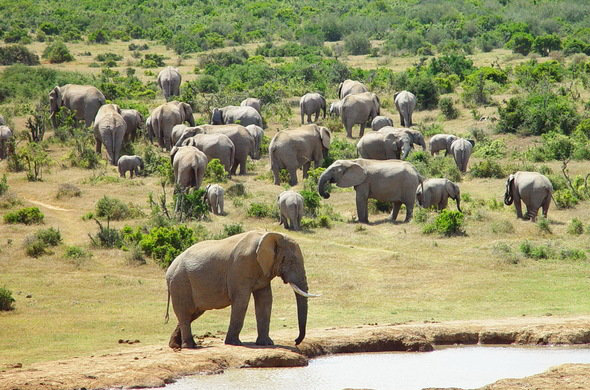

'Image is most likely (with probability):'

[('n02504458', 'African_elephant', 0.9674866),
 ('n02408429', 'water_buffalo', 0.012640192),
 ('n02504013', 'Indian_elephant', 0.0105395615)]


Image size =  (960, 640) Image:


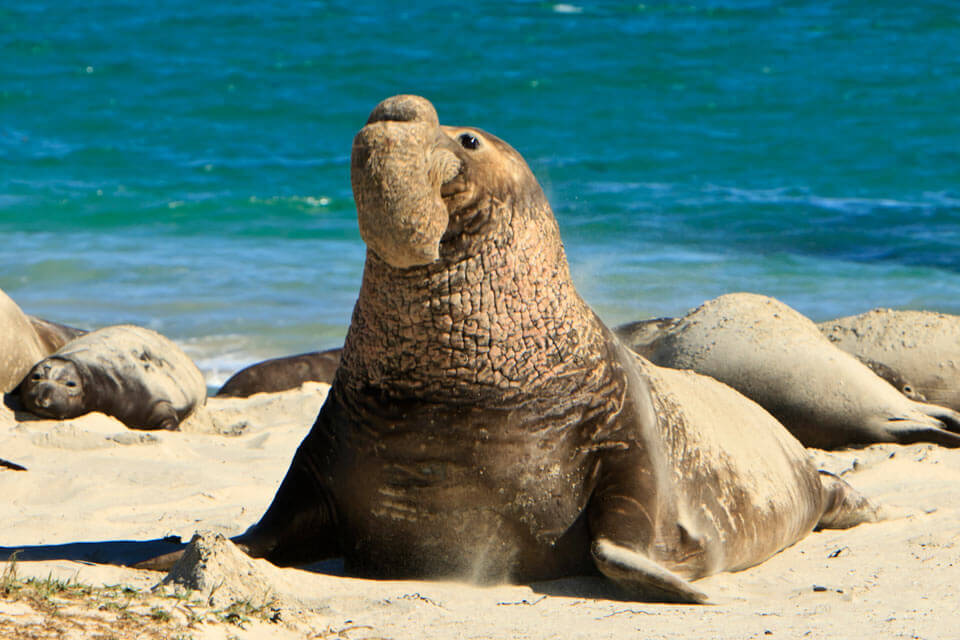

'Image is most likely (with probability):'

[('n02077923', 'sea_lion', 0.99131876),
 ('n09428293', 'seashore', 0.0010251433),
 ('n02894605', 'breakwater', 0.0010100761)]


Image size =  (1280, 720) Image:


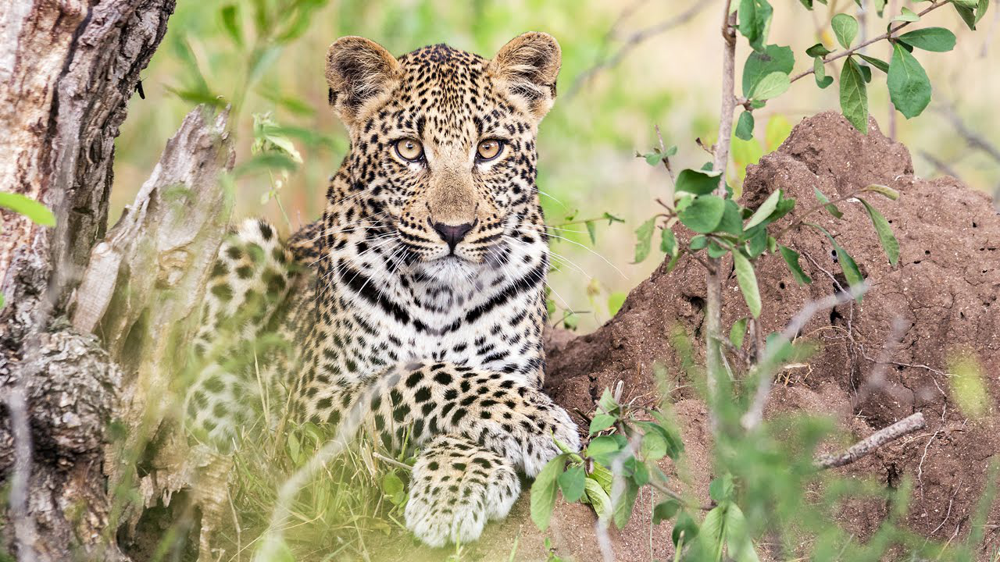

'Image is most likely (with probability):'

[('n02128385', 'leopard', 0.8464764),
 ('n02128925', 'jaguar', 0.1442565),
 ('n02129604', 'tiger', 0.0047887983)]


Image size =  (685, 364) Image:


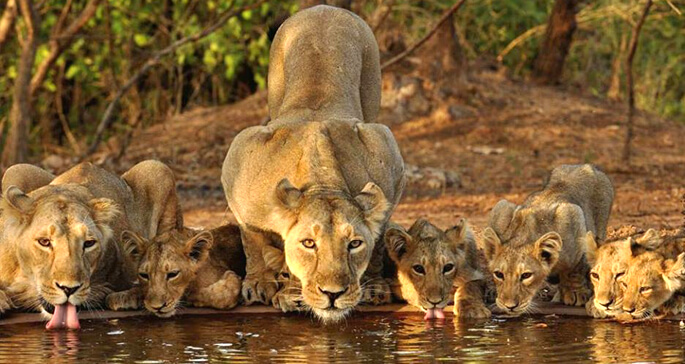

'Image is most likely (with probability):'

[('n02397096', 'warthog', 0.50058687),
 ('n02396427', 'wild_boar', 0.2602599),
 ('n02395406', 'hog', 0.105386615)]


Image size =  (1600, 900) Image:


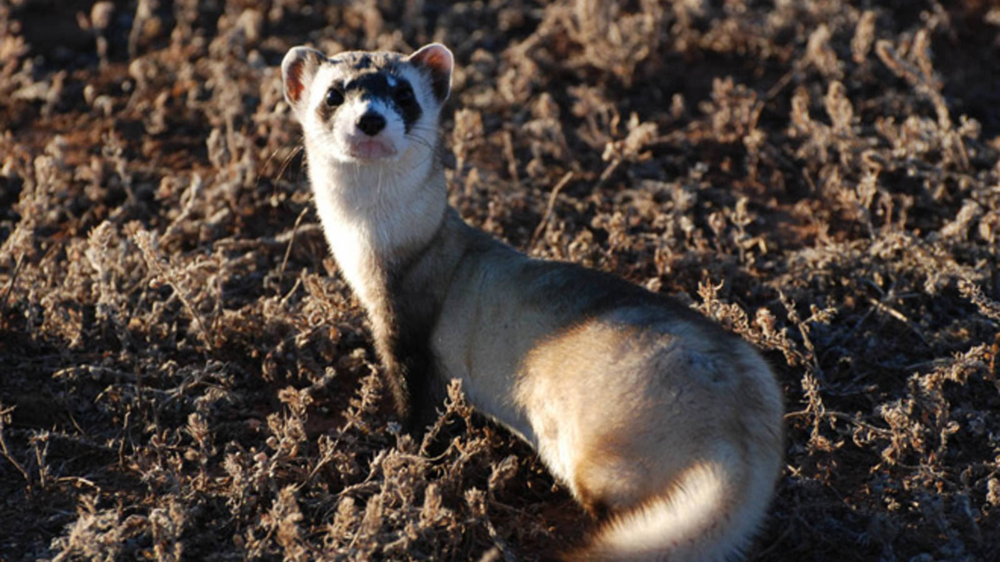

'Image is most likely (with probability):'

[('n02423022', 'gazelle', 0.4218734),
 ('n01877812', 'wallaby', 0.26237068),
 ('n02447366', 'badger', 0.0735109)]


Image size =  (640, 360) Image:


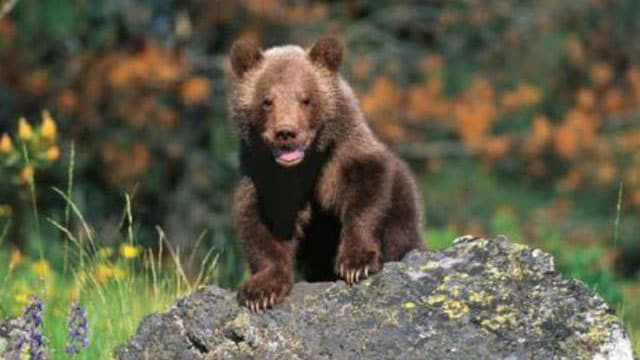

'Image is most likely (with probability):'

[('n02132136', 'brown_bear', 0.98519325),
 ('n02133161', 'American_black_bear', 0.013398946),
 ('n02105056', 'groenendael', 0.00051687076)]


Image size =  (1600, 900) Image:


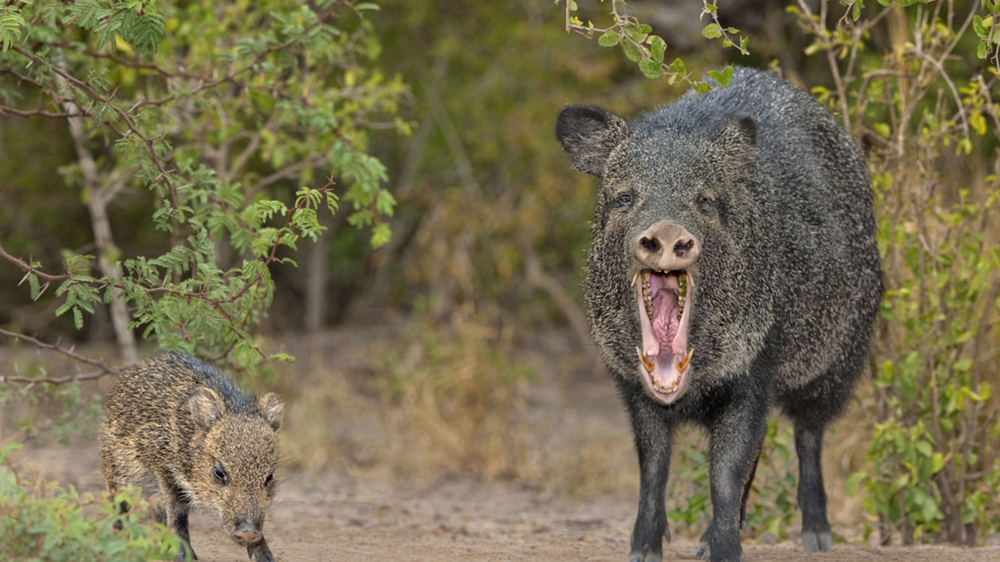

'Image is most likely (with probability):'

[('n02120505', 'grey_fox', 0.29400292),
 ('n02114367', 'timber_wolf', 0.11311486),
 ('n02114855', 'coyote', 0.10668613)]


Image size =  (1280, 720) Image:


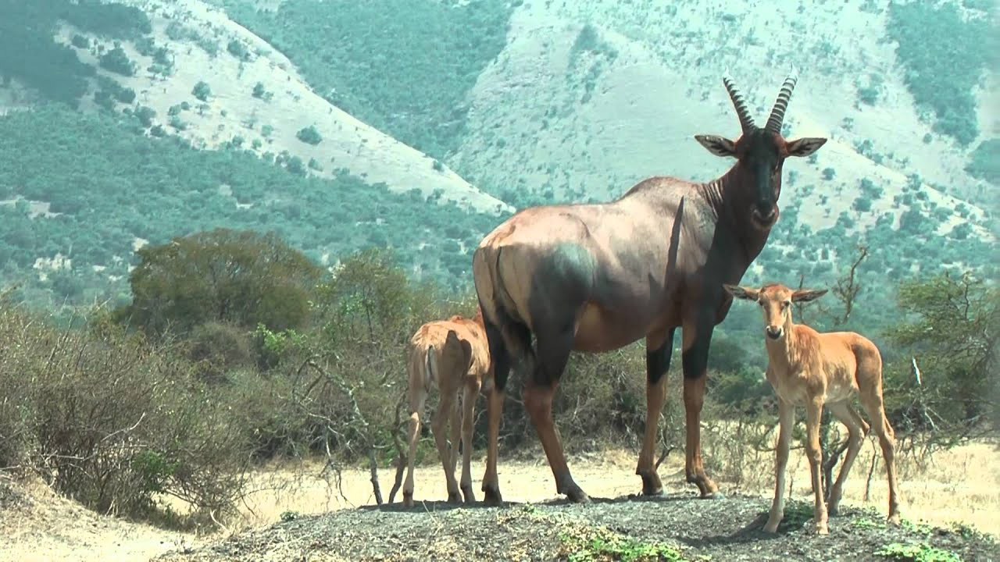

'Image is most likely (with probability):'

[('n02422106', 'hartebeest', 0.98432714),
 ('n02423022', 'gazelle', 0.0049480633),
 ('n02437312', 'Arabian_camel', 0.0031021708)]


Image size =  (550, 366) Image:


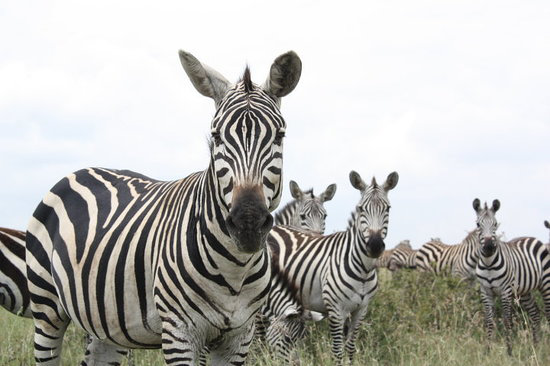

'Image is most likely (with probability):'

[('n02391049', 'zebra', 0.99995625),
 ('n02422106', 'hartebeest', 2.0407286e-05),
 ('n02422699', 'impala', 1.1149621e-05)]


Image size =  (755, 440) Image:


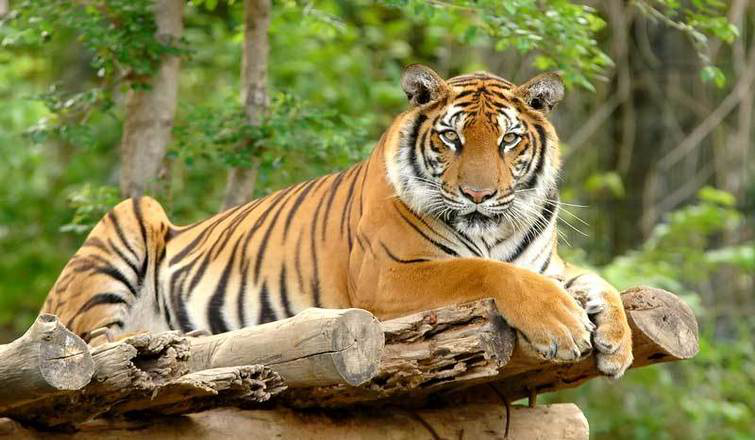

'Image is most likely (with probability):'

[('n02129604', 'tiger', 0.8434663),
 ('n02123159', 'tiger_cat', 0.14193927),
 ('n02128925', 'jaguar', 0.0071617505)]


Image size =  (660, 371) Image:


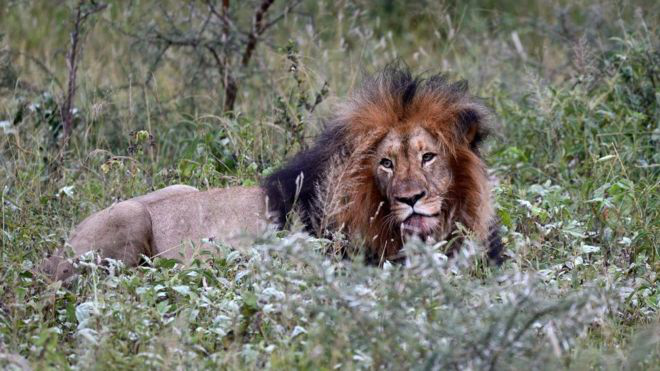

'Image is most likely (with probability):'

[('n02129165', 'lion', 0.79962486),
 ('n02115913', 'dhole', 0.05237063),
 ('n02106030', 'collie', 0.03203463)]


Image size =  (990, 663) Image:


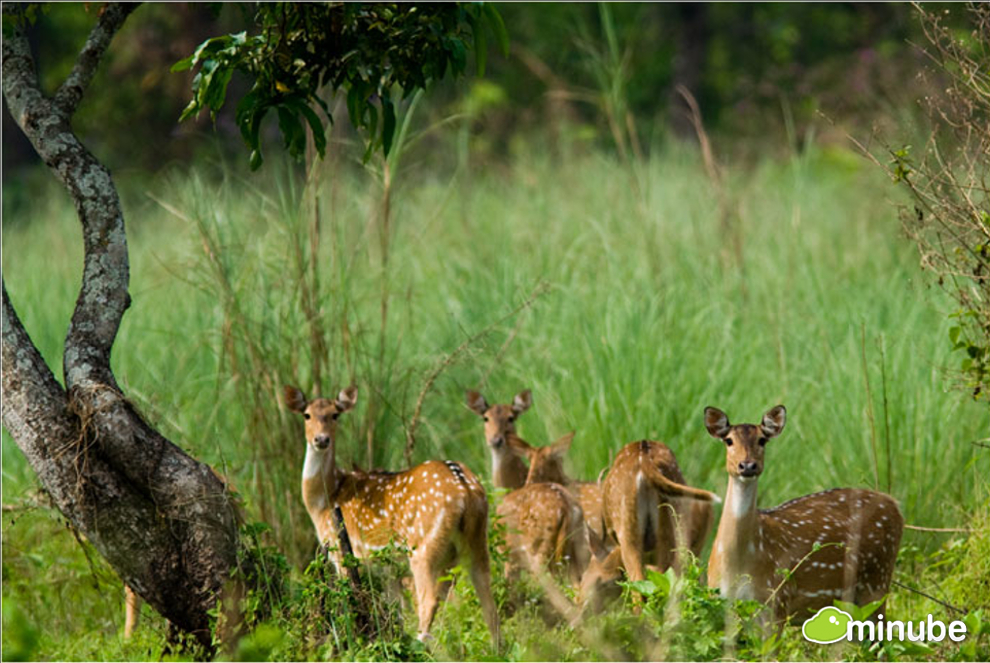

'Image is most likely (with probability):'

[('n02326432', 'hare', 0.2672008),
 ('n02115913', 'dhole', 0.1602501),
 ('n02423022', 'gazelle', 0.13811089)]


Image size =  (1200, 900) Image:


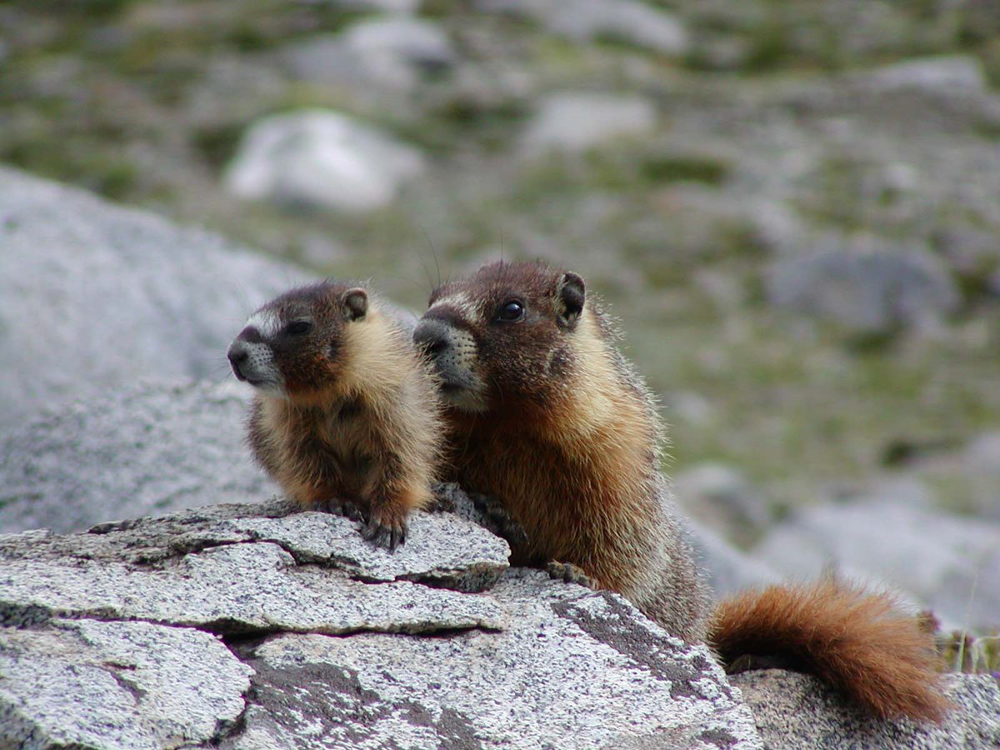

'Image is most likely (with probability):'

[('n02361337', 'marmot', 0.9998926),
 ('n02138441', 'meerkat', 7.490677e-05),
 ('n02137549', 'mongoose', 2.6379847e-05)]


Image size =  (748, 499) Image:


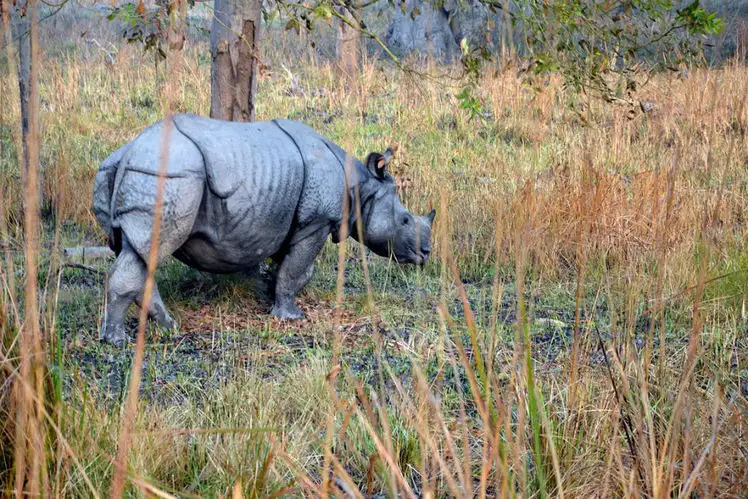

'Image is most likely (with probability):'

[('n02397096', 'warthog', 0.66553235),
 ('n02398521', 'hippopotamus', 0.092899546),
 ('n02454379', 'armadillo', 0.041796785)]


Image size =  (750, 450) Image:


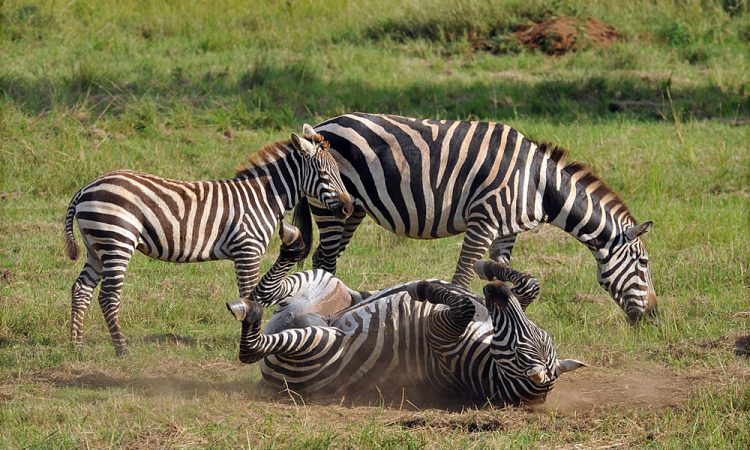

'Image is most likely (with probability):'

[('n02391049', 'zebra', 0.9979431),
 ('n02422106', 'hartebeest', 0.0002631924),
 ('n01798484', 'prairie_chicken', 0.00021379338)]


Image size =  (1280, 718) Image:


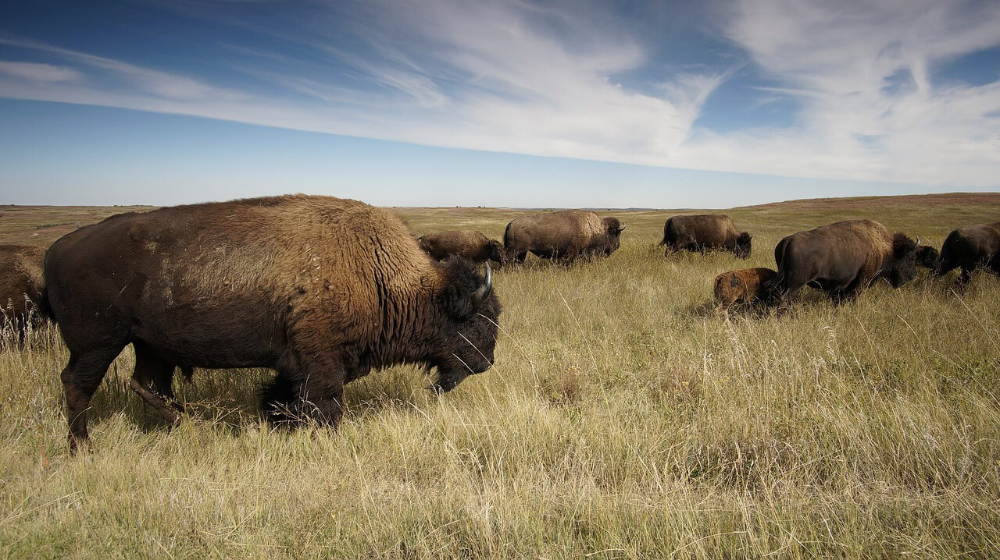

'Image is most likely (with probability):'

[('n02410509', 'bison', 0.99975306),
 ('n07802026', 'hay', 0.00010129162),
 ('n02403003', 'ox', 5.7782574e-05)]

In [0]:
### YOUR CODE HERE
import os
from keras.preprocessing import image
import numpy as np
from keras.applications.resnet50 import preprocess_input
from keras.applications.resnet50 import ResNet50
from keras.applications.resnet50 import decode_predictions

path = '/content/downloads/animal national park/'

files = []
# r=root, d=directories, f = files
for r, d, f in os.walk(path):
    for file in f:
        if '.jpg' in file:
            files.append(os.path.join(r, file))

for f in files:
    img = image.load_img(f)
    shape = (img.size[1], img.size[0], 3)
    print("\nImage size = ", img.size, "Image:")
    display(img)
    img_model = image.load_img(f, target_size=(224, 224, 3))
    img_np = np.expand_dims(image.img_to_array(img_model), axis=0)
    img_keras = preprocess_input(img_np)
    #model = ResNet50(weights='imagenet', include_top=False, input_shape=shape)
    model = ResNet50(weights='imagenet')
    features = model.predict(img_keras)
    display("Image is most likely (with probability):", decode_predictions(features, top=3)[0])
    #break

In [0]:
import glob

path = '/content/downloads/animal national park/'

files = [f for f in glob.glob(path + "**/*.jpg", recursive=True)]

for f in files:
    print(f)


# Resources and Stretch Goals

Stretch goals
- Enhance your code to use classes/functions and accept terms to search and classes to look for in recognizing the downloaded images (e.g. download images of parties, recognize all that contain balloons)
- Check out [other available pretrained networks](https://tfhub.dev), try some and compare
- Image recognition/classification is somewhat solved, but *relationships* between entities and describing an image is not - check out some of the extended resources (e.g. [Visual Genome](https://visualgenome.org/)) on the topic
- Transfer learning - using images you source yourself, [retrain a classifier](https://www.tensorflow.org/hub/tutorials/image_retraining) with a new category
- (Not CNN related) Use [piexif](https://pypi.org/project/piexif/) to check out the metadata of images passed in to your system - see if they're from a national park! (Note - many images lack GPS metadata, so this won't work in most cases, but still cool)

Resources
- [Deep Residual Learning for Image Recognition](https://arxiv.org/abs/1512.03385) - influential paper (introduced ResNet)
- [YOLO: Real-Time Object Detection](https://pjreddie.com/darknet/yolo/) - an influential convolution based object detection system, focused on inference speed (for applications to e.g. self driving vehicles)
- [R-CNN, Fast R-CNN, Faster R-CNN, YOLO](https://towardsdatascience.com/r-cnn-fast-r-cnn-faster-r-cnn-yolo-object-detection-algorithms-36d53571365e) - comparison of object detection systems
- [Common Objects in Context](http://cocodataset.org/) - a large-scale object detection, segmentation, and captioning dataset
- [Visual Genome](https://visualgenome.org/) - a dataset, a knowledge base, an ongoing effort to connect structured image concepts to language